# Velib Data Visualisation Project

In [377]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

## Import

### Thursday

In [378]:
files = ['thu-10h.csv','thu-12h.csv','thu-16h.csv','thu-19h.csv','thu-22h.csv']

df_list = [pd.read_csv(f'data/thu-17/{file}', delimiter=';') for file in files]
df_thursday = pd.concat(df_list, ignore_index=True)
df_thursday = df_thursday.sort_values('stationcode')
df_thursday.reset_index(drop=True, inplace=True)

### Friday

In [379]:
files = ['fri-2h.csv','fri-9h.csv','fri-10h.csv','fri-12h.csv','fri-16h.csv','fri-19h.csv','fri-22h.csv']

df_list = [pd.read_csv(f'data/fri-18/{file}', delimiter=';') for file in files]
df_friday = pd.concat(df_list, ignore_index=True)
df_friday = df_friday.sort_values('stationcode')
df_friday.reset_index(drop=True, inplace=True)

### Saturday

In [380]:
files = ['sat-2h.csv','sat-7h.csv','sat-9h.csv','sat-10h.csv','sat-12h.csv','sat-16h.csv','sat-19h.csv','sat-22h.csv']

df_list = [pd.read_csv(f'data/sat-18/{file}', delimiter=';') for file in files]
df_saturday = pd.concat(df_list, ignore_index=True)
df_saturday = df_saturday.sort_values('stationcode')
df_saturday.reset_index(drop=True, inplace=True)

## Cleaning

In [381]:
df_thursday = df_thursday[(df_thursday['is_installed'] == 'OUI')]
df_thursday = df_thursday[(df_thursday['is_returning']=='OUI') & (df_thursday['is_renting']=='OUI')]
df_thursday['duedate'] = pd.to_datetime(df_thursday['duedate'], errors='coerce')
df_thursday.drop(columns=['is_installed','is_renting','is_returning'])
df_thursday['nom_arrondissement_communes'] = df_thursday['nom_arrondissement_communes'].str.lower()
df_thursday.reset_index(drop=True,inplace=True)

In [382]:
df_friday = df_friday[df_friday['is_installed'] == 'OUI']
df_friday = df_friday[(df_friday['is_returning']=='OUI') & (df_friday['is_renting']=='OUI')]
df_friday['duedate'] = pd.to_datetime(df_friday['duedate'], errors='coerce')
df_friday.drop(columns=['is_installed','is_renting','is_returning'])
df_friday['nom_arrondissement_communes'] = df_friday['nom_arrondissement_communes'].str.lower()
df_friday.reset_index(drop=True,inplace=True)

In [383]:
df_saturday = df_saturday[df_saturday['is_installed'] == 'OUI']
df_saturday = df_saturday[(df_saturday['is_returning']=='OUI') & (df_saturday['is_renting']=='OUI')]
df_saturday['duedate'] = pd.to_datetime(df_saturday['duedate'], errors='coerce')
df_saturday.drop(columns=['is_installed','is_renting','is_returning'])
df_saturday['nom_arrondissement_communes'] = df_saturday['nom_arrondissement_communes'].str.lower()
df_saturday.reset_index(drop=True,inplace=True)

## EDA

In [384]:
df_thursday.describe()

,stationcode,capacity,numdocksavailable,numbikesavailable,mechanical,ebike,code_insee_commune
count,7160.000000,7160.000000,7160.000000,7160.000000,7160.000000,7160.000000,7160.000000
mean,18714.630587,31.629190,18.280447,12.255587,7.799162,4.456425,80868.437849
std,12172.944979,11.737279,12.244887,12.005099,9.815416,4.344863,8357.634783
min,1001.000000,6.000000,0.000000,0.000000,0.000000,0.000000,75056.000000
25%,11030.750000,23.000000,8.000000,3.000000,1.000000,2.000000,75056.000000
50%,16126.500000,29.500000,17.000000,8.000000,4.000000,3.000000,75056.000000
75%,22012.250000,37.000000,26.000000,18.000000,12.000000,6.000000,92040.000000
max,92008.000000,76.000000,63.000000,79.000000,65.000000,40.000000,95018.000000


In [385]:
df_friday.describe()

,stationcode,capacity,numdocksavailable,numbikesavailable,mechanical,ebike,code_insee_commune
count,10032.000000,10032.000000,10032.000000,10032.000000,10032.000000,10032.000000,10032.000000
mean,18704.494119,31.623604,18.708433,11.731360,7.565391,4.165969,80863.802731
std,12174.054395,11.737155,11.984081,11.378758,9.587614,4.091451,8355.745866
min,1001.000000,6.000000,0.000000,0.000000,0.000000,0.000000,75056.000000
25%,11030.000000,23.000000,10.000000,3.000000,1.000000,1.000000,75056.000000
50%,16124.000000,29.000000,18.000000,8.000000,4.000000,3.000000,75056.000000
75%,22012.000000,37.000000,26.000000,17.000000,11.000000,6.000000,92040.000000
max,92008.000000,76.000000,67.000000,78.000000,64.000000,43.000000,95018.000000


In [386]:
df_saturday.describe()

,stationcode,capacity,numdocksavailable,numbikesavailable,mechanical,ebike,code_insee_commune
count,11480.000000,11480.000000,11480.000000,11480.000000,11480.000000,11480.000000,11480.000000
mean,18706.183275,31.624390,18.202352,12.194599,7.715418,4.479181,80856.286411
std,12166.188168,11.744427,12.056076,10.784989,9.464379,3.965100,8352.895030
min,1001.000000,6.000000,0.000000,0.000000,0.000000,0.000000,75056.000000
25%,11030.000000,23.000000,9.000000,4.000000,1.000000,2.000000,75056.000000
50%,16129.000000,29.000000,17.000000,9.000000,4.000000,3.000000,75056.000000
75%,22012.000000,37.000000,25.000000,17.000000,11.000000,6.000000,92040.000000
max,92008.000000,76.000000,70.000000,69.000000,68.000000,47.000000,95018.000000


In [387]:
%matplotlib inline
from ydata_profiling import ProfileReport

profile = ProfileReport(df_thursday, title="Velib Dataset Profiling Report")
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#### **`capacity`**
- Mean: 31.63
- Min: 6
- Max: 76

#### **`numdocksavailable`**
- Mean: 18.28
- Min: 0
- Max: 63

#### **`mechanical`**
- Mean: 7.79

#### **`ebike`**
- Mean: 4.46

#### **`nom_arrondissement_communes`**
- 66.4% Paris 
- 2% Boulogne-Billancourt
- 1.6% Montreuil

---

#### **Correlation**
**Correlation**
(Trivial)
- ebike vs numbikesavailable (0.719)
- mechanical vs numbikesavailable (0.919)

=> Station contains more mechanical than ebike

**Anti-correlation**
- mechanical vs numdocksavailable (-0.578)
- ebike vs numdocksavailable (-0.437)

## Basic Visualization

In [388]:
df_stations= df_thursday[['name','nom_arrondissement_communes','coordonnees_geo','code_insee_commune']]
df_stations.drop_duplicates(inplace=True)

/var/folders/jf/fj2024y95fq3vks7z8x5bxnh0000gn/T/ipykernel_7091/1647252580.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



/var/folders/jf/fj2024y95fq3vks7z8x5bxnh0000gn/T/ipykernel_7091/368182027.py:6: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




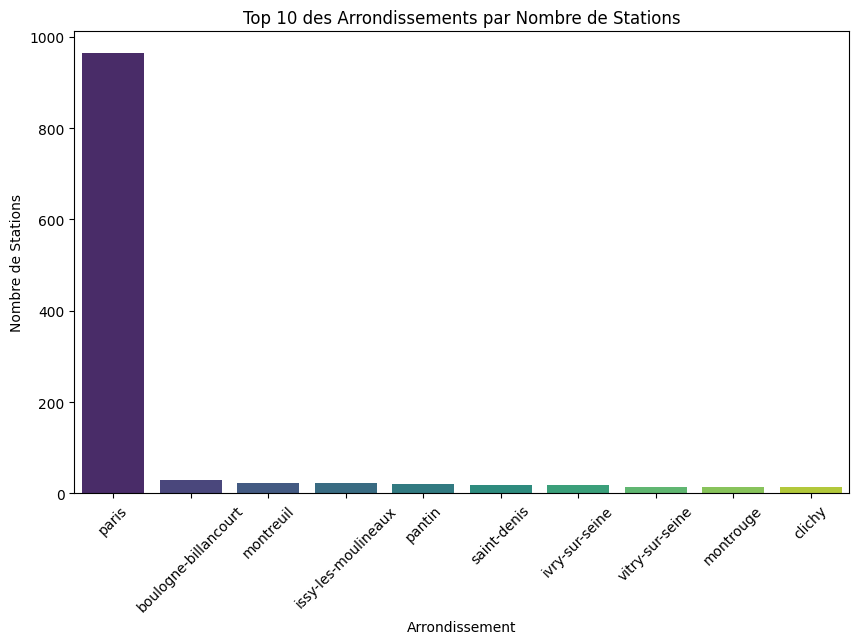

In [389]:
%matplotlib inline

top_cities = df_stations['nom_arrondissement_communes'].value_counts().nlargest(10)

plt.figure(figsize=(10, 6))
sns.barplot(x=top_cities.index, y=top_cities.values, palette='viridis')
plt.title('Top 10 des Arrondissements par Nombre de Stations')
plt.xlabel('Arrondissement')
plt.ylabel('Nombre de Stations')
plt.xticks(rotation=45)
plt.show()

In [390]:
import plotly.express as px
import plotly.io as pio
import streamlit as st

# Vos données (assurez-vous que df_stations est déjà défini)
top_cities = df_stations['nom_arrondissement_communes'].value_counts().nlargest(10).reset_index()
top_cities.columns = ['Arrondissement', 'Nombre de Stations']

# Création du graphique
fig = px.bar(top_cities, 
             x='Arrondissement', 
             y='Nombre de Stations', 
             title='Top 10 des Arrondissements par Nombre de Stations',
             labels={'Nombre de Stations': 'Nombre de Stations', 'Arrondissement': 'Arrondissement'},
             color='Nombre de Stations',
             color_continuous_scale='viridis')

# Enregistrement du graphique en tant que fichier HTML
pio.write_html(fig, 'top_cities_graph.html')

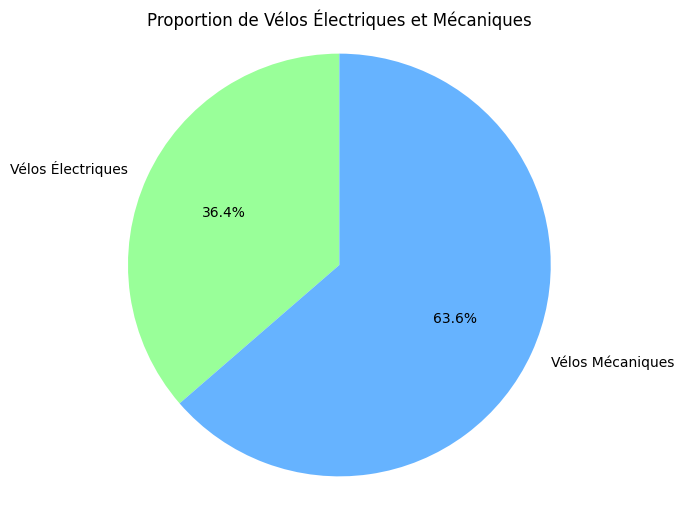

In [391]:
total_ebike = df_thursday['ebike'].sum()
total_mechanical = df_thursday['mechanical'].sum()

labels = ['Vélos Électriques', 'Vélos Mécaniques']
sizes = [total_ebike, total_mechanical]
colors = ['#99ff99', '#66b3ff']  

plt.figure(figsize=(6, 6)) 
plt.pie(sizes, labels=labels, colors=colors, autopct='%1.1f%%', startangle=90)
plt.axis('equal')  

plt.title("Proportion de Vélos Électriques et Mécaniques")
plt.show()

In [442]:
import plotly.express as px

# Calcul des totaux
total_ebike = df_thursday['ebike'].sum()
total_mechanical = df_thursday['mechanical'].sum()

# Données pour le graphique
labels = ['Électrique', 'Méchanique']
sizes = [total_ebike, total_mechanical]
colors = ['#99ff99','#66b3ff']

# Création du diagramme circulaire
fig = px.pie(names=labels, values=sizes, 
             title="Proportion de Vélos Électriques et Mécaniques journée du jeudi",
             color_discrete_sequence=colors)

# Personnalisation
fig.update_traces(textinfo='percent+label', pull=[0.1, 0])  # Met en avant la première part
fig.update_layout(showlegend=False)

# Affichage du graphique
fig.show()
pio.write_html(fig, 'rate_bike.html')

In [393]:
import pandas as pd
import folium
from folium.plugins import MarkerCluster

df_stations[['latitude', 'longitude']] = df_stations['coordonnees_geo'].str.split(',', expand=True).astype(float)

m = folium.Map(location=[48.8566, 2.3522], zoom_start=12)

marker_cluster = MarkerCluster().add_to(m)

for index, row in df_stations.iterrows():
    folium.Marker(
        location=[float(row['latitude']), float(row['longitude'])],
        popup=row['name'],  
        icon=folium.Icon(color='blue',icon='bicycle',prefix='fa')  # Personnaliser l'icône
    ).add_to(marker_cluster)

# Sauvegarder la carte sous forme de fichier HTML
m.save("carte_stations_paris_cluster.html")
m


/var/folders/jf/fj2024y95fq3vks7z8x5bxnh0000gn/T/ipykernel_7091/1774313675.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/jf/fj2024y95fq3vks7z8x5bxnh0000gn/T/ipykernel_7091/1774313675.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



## Densité des stations (Paris vs Banlieue)

In [394]:
df_paris = df_stations[df_stations['nom_arrondissement_communes']=='paris']
df_banlieue = df_stations[df_stations['nom_arrondissement_communes']!='paris']

In [395]:
df_paris.head()

,name,nom_arrondissement_communes,coordonnees_geo,code_insee_commune,latitude,longitude
0,Quai de l'Horloge - Pont Neuf,paris,"48.857058739111,2.3417982839439",75056,48.857059,2.341798
5,Victoria - Place du Chatelet,paris,"48.857992591527,2.3469167947769",75056,48.857993,2.346917
10,Saint-Denis - Rivoli,paris,"48.859059340842,2.3476943001151",75056,48.859059,2.347694
15,Grande Truanderie - Saint-Denis,paris,"48.8626302,2.3498075",75056,48.862630,2.349807
20,Turbigo - Française,paris,"48.86358858111446,2.3477794602513313",75056,48.863589,2.347779


In [396]:
import pandas as pd
import folium
from folium.plugins import HeatMap

df_paris = df_stations[df_stations['nom_arrondissement_communes']=='paris']
df_banlieue = df_stations[df_stations['nom_arrondissement_communes']!='paris']

# Créer la carte centrée sur Paris
m = folium.Map(location=[48.8566, 2.3522], zoom_start=12)

# Ajouter la heatmap pour Paris
heat_data_paris = [[row['latitude'], row['longitude']] for index, row in df_stations.iterrows()]
HeatMap(heat_data_paris, radius=15, blur=10, gradient={0.4: 'red', 0.65: 'orange', 1: 'green'}, name="Paris").add_to(m)

# Ajouter la heatmap pour la banlieue
#heat_data_banlieue = [[row['latitude'], row['longitude']] for index, row in df_banlieue.iterrows()]
#HeatMap(heat_data_banlieue, radius=15, blur=10, gradient={0.4: 'red', 0.65: 'orange', 1: 'green'}, name="Banlieue").add_to(m)

# Ajouter le contrôle des couches
folium.LayerControl().add_to(m)

# Sauvegarder la carte sous forme de fichier HTML
m.save("carte_densite_stations_paris_banlieue.html")

# Afficher la carte
m



In [397]:
import folium
import geopandas as gpd
import pandas as pd

df_stations = df_thursday[['name', 'nom_arrondissement_communes', 'coordonnees_geo', 'code_insee_commune','capacity']]
df_stations.drop_duplicates(inplace=True)

geojson_file = "communes-france.geojson"  
geo_data = gpd.read_file(geojson_file)

population_file = "population.xlsx" 
population_data = pd.read_excel(population_file)

population_data.columns = population_data.columns.str.strip()
geo_data.columns = geo_data.columns.str.strip()

population_data.rename(columns={'codgeo': 'code_insee_commune'}, inplace=True)

df_stations['code_insee_commune'] = df_stations['code_insee_commune'].astype(str)


df_stations = df_stations.merge(population_data[['code_insee_commune', 'p21_pop']], 
                                 on='code_insee_commune', 
                                 how='left')

df_stations.rename(columns={'p21_pop': 'population'}, inplace=True)

df_stations.loc[df_stations['code_insee_commune'] == '75056', 'population'] = 2133111


print(df_stations.head())

/var/folders/jf/fj2024y95fq3vks7z8x5bxnh0000gn/T/ipykernel_7091/708263322.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

Skipping field reg_code: unsupported OGR type: 5
Skipping field reg_name: unsupported OGR type: 5
Skipping field dep_code: unsupported OGR type: 5
Skipping field dep_name: unsupported OGR type: 5
Skipping field arrdep_code: unsupported OGR type: 5
Skipping field arrdep_name: unsupported OGR type: 5
Skipping field ze2020_code: unsupported OGR type: 5
Skipping field ze2020_name: unsupported OGR type: 5
Skipping field bv2022_code: unsupported OGR type: 5
Skipping field bv2022_name: unsupported OGR type: 5
Skipping field epci_code: unsupported OGR type: 5
Skipping field epci_name: unsupported OGR type: 5
Skipping field ept_code: unsupported OGR type: 5
Skipping field ept_name: unsup

                              name nom_arrondissement_communes  \
0    Quai de l'Horloge - Pont Neuf                       paris   
1     Victoria - Place du Chatelet                       paris   
2             Saint-Denis - Rivoli                       paris   
3  Grande Truanderie - Saint-Denis                       paris   
4              Turbigo - Française                       paris   

                        coordonnees_geo code_insee_commune  capacity  \
0       48.857058739111,2.3417982839439              75056        17   
1       48.857992591527,2.3469167947769              75056        22   
2       48.859059340842,2.3476943001151              75056        43   
3                  48.8626302,2.3498075              75056        33   
4  48.86358858111446,2.3477794602513313              75056        16   

   population  
0   2133111.0  
1   2133111.0  
2   2133111.0  
3   2133111.0  
4   2133111.0  


/var/folders/jf/fj2024y95fq3vks7z8x5bxnh0000gn/T/ipykernel_7091/708263322.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [398]:
df_stations['nom_arrondissement_communes'] = df_stations['nom_arrondissement_communes'].str.lower()

stations_par_commune = df_stations.groupby('nom_arrondissement_communes').agg(
    station_count=('nom_arrondissement_communes', 'size'),
    total_capacity=('capacity', 'sum')
).reset_index()

geo_data_filtered = geo_data[geo_data['com_name_lower'].isin(stations_par_commune['nom_arrondissement_communes'])]

geo_data_filtered = geo_data_filtered.merge(stations_par_commune, 
                                            left_on='com_name_lower', 
                                            right_on='nom_arrondissement_communes', 
                                            how='left')

geo_data_filtered['station_count'].fillna(0, inplace=True)
geo_data_filtered['total_capacity'].fillna(0, inplace=True)

geo_data_filtered = geo_data_filtered.merge(df_stations[['nom_arrondissement_communes', 'population']], 
                           left_on='com_name_lower', 
                           right_on='nom_arrondissement_communes', 
                           how='left')

geo_data_filtered['population'].fillna(0, inplace=True)

geo_data_filtered['capacity_per_inhabitant'] = geo_data_filtered['total_capacity'] / geo_data_filtered['population'].replace(0, pd.NA)




/var/folders/jf/fj2024y95fq3vks7z8x5bxnh0000gn/T/ipykernel_7091/3380037650.py:15: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/var/folders/jf/fj2024y95fq3vks7z8x5bxnh0000gn/T/ipykernel_7091/3380037650.py:16: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing '

In [443]:
import folium
import numpy as np

min_stations = geo_data_filtered['capacity_per_inhabitant'].min()
max_stations = geo_data_filtered['capacity_per_inhabitant'].max()
geo_data_filtered['normalized_stations'] = (geo_data_filtered['capacity_per_inhabitant'] - min_stations) / (max_stations - min_stations)

m = folium.Map(location=[48.8566, 2.3522], zoom_start=10)

def get_color_and_opacity(normalized_value):
    if normalized_value < 0:
        return ('white', 0)  # Aucune station
    elif normalized_value <= 0.25:
        return ('#fc0000', 0.8)  # Rouge
    elif normalized_value <= 0.5:
        return ('#fc8700', 0.6)  # Orange
    elif normalized_value <= 0.75:
        return ('#fcdf00', 0.4)  # Jaune
    else:
        return ('green', 0.2)  # Vert

for _, row in geo_data_filtered.iterrows():
    color, opacity = get_color_and_opacity(row['normalized_stations'])
    folium.GeoJson(
        row['geometry'],
        style_function=lambda feature, fill_color=color, fill_opacity=opacity: {
            'fillColor': fill_color,  
            'color': 'black',
            'weight': 0.5,
            'fillOpacity': fill_opacity,
        },
        tooltip=folium.Tooltip(f"{row['com_name_lower']}: {row['station_count']} stations, {row['capacity_per_inhabitant']*1000:.4f} vélos pour 1000 habitants")
    ).add_to(m)


m.save("carte_densite2.html")
m


## TOP 10 Stations Vélib Electrique

In [421]:
frames = [df_thursday,df_friday,df_saturday]
df_all = pd.concat(frames)

In [428]:
stations = df_all['stationcode'].unique()

print(stations.shape[0])

1435


In [440]:
capacity = df_all[['stationcode', 'capacity']].drop_duplicates(subset='stationcode')
print("Rack dispo: ",capacity.sum())

Rack dispo:  stationcode    26843373
capacity          45381
dtype: int64


In [441]:
nb_bikes = df_all.groupby(['name'], as_index=False)['numbikesavailable'].mean()
print("Bikes available:",nb_bikes['numbikesavailable'].sum())

Bikes available: 17255.397222222222


In [ ]:
nb_bikes2 = df_all[['stationcode', 'capacity']].drop_duplicates(subset='stationcode')


In [401]:
df_all['ebike_rate'] = df_all['ebike'] / df_all['numbikesavailable']

In [402]:
df_all = df_all[['name','ebike_rate','coordonnees_geo']]

In [403]:
df_all = df_all.groupby(['name','coordonnees_geo'], as_index=False)['ebike_rate'].mean()

In [404]:
print(f"Il y a {round((df_all[df_all['ebike_rate']>=0.5].shape[0]/df_all.shape[0]*100), 2)}% stations avec plus de 50% de vélib électriqyes")

Il y a 48.99% stations avec plus de 50% de vélib électriqyes


In [405]:
import plotly.graph_objects as go

x_values = np.arange(0, 101)
y_values = [(df_all[df_all['ebike_rate'] *100 >= x].shape[0]) for x in x_values]

fig = go.Figure()

my_text = [f"{y} stations avec {x}% de ebike" for x, y in zip(x_values, y_values)]

# Ajout des données pour les vélos électriques
fig.add_trace(go.Scatter(
    x=x_values,
    y=y_values,
    mode='lines',
    line=dict(color='blue'),
    marker=dict(size=8),
    text=my_text,
    hoverinfo='text'
))


# Personnalisation de la mise en page
fig.update_layout(
    title='Proportion de stations ayant x% de vélib éléctrique',
    xaxis_title='% de vélib électriques',
    yaxis_title='# de stations',
    template='plotly_white'
)

# Affichage du graphique
fig.show()
pio.write_html(fig, 'proportion_ebike.html')


In [406]:
df_all.sort_values(by="ebike_rate",ascending=False, inplace=True)

In [407]:
df_all.head()

,name,coordonnees_geo,ebike_rate
711,Lieutenant Chauré - Etienne Marey,"48.86746195408435,2.405970990657807",1.0
1339,Sèvres Rive Gauche,"48.821443218278,2.2150785306885",1.0
683,Lassus - Delouvain,"48.8755044846,2.3890327325519",1.0
1109,Porte de Ménilmontant,"48.8691543609174,2.40932246879487",1.0
93,Belleville - Porte des Lilas,"48.87660391892763,2.404769691129476",1.0


In [408]:
top_10_ebike = df_all.head(30)

In [409]:
top_10_ebike = pd.DataFrame(top_10_ebike)

In [410]:
print(top_10_ebike)

                                               name  \
711               Lieutenant Chauré - Etienne Marey   
1339                             Sèvres Rive Gauche   
683                              Lassus - Delouvain   
1109                          Porte de Ménilmontant   
93                     Belleville - Porte des Lilas   
1170          Raymond Poincaré - Allée de la Marche   
659                                       Karl Marx   
1006                           Place Nelson Mandela   
230                 Chastenet de Géry - Marcel Paul   
1281                   Solitaires - Place des Fêtes   
759                           Mairie de Romainville   
693                         Lebrun - Colonel Fabien   
1274                                      Serrurier   
1308                   Square de la rue Pixérécourt   
1425                                  Véron - Lepic   
129                              Borrégo - Gambetta   
976                      Place Du Général De Gaulle   
1413      

In [411]:
import pandas as pd
import folium
from folium.plugins import MarkerCluster

top_10_ebike[['latitude', 'longitude']] = top_10_ebike['coordonnees_geo'].str.split(',', expand=True).astype(float)

m = folium.Map(location=[48.8566, 2.3522], zoom_start=12)

marker_cluster = MarkerCluster().add_to(m)

for index, row in top_10_ebike.iterrows():
    folium.Marker(
        location=[float(row['latitude']), float(row['longitude'])],
        popup=row['name'],  
        icon=folium.Icon(color='blue',icon='bicycle',prefix='fa')  # Personnaliser l'icône
    ).add_to(marker_cluster)

# Sauvegarder la carte sous forme de fichier HTML
m.save("carte_top_10_ebike.html")
m


## Disponibilités des vélos au cours de la journée


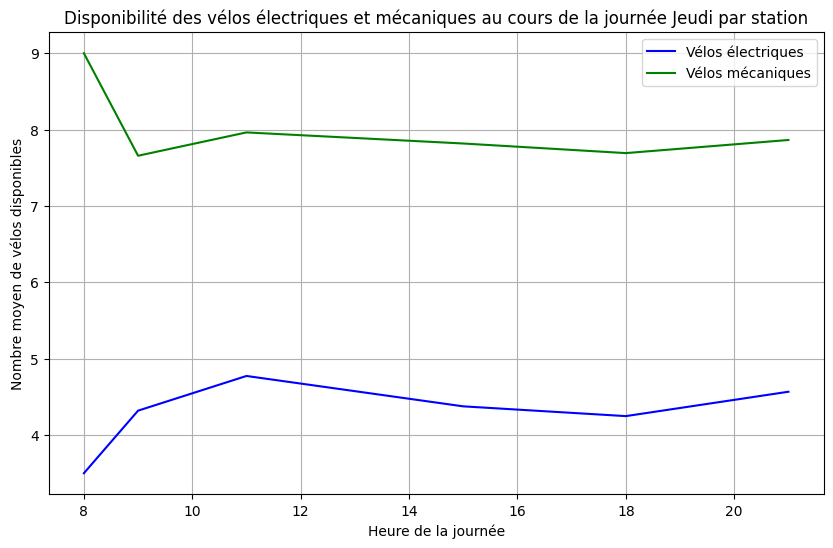

In [412]:
df_thursday['hour'] = df_thursday['duedate'].dt.hour

availability_per_hour = df_thursday.groupby('hour').agg(
    avg_electric_bikes=('ebike', 'mean'),
    avg_mechanical_bikes=('mechanical', 'mean')
).reset_index()

plt.figure(figsize=(10, 6))

plt.plot(availability_per_hour['hour'], availability_per_hour['avg_electric_bikes'], label='Vélos électriques', color='blue')
plt.plot(availability_per_hour['hour'], availability_per_hour['avg_mechanical_bikes'], label='Vélos mécaniques', color='green')

plt.xlabel('Heure de la journée')
plt.ylabel('Nombre moyen de vélos disponibles')
plt.title('Disponibilité des vélos électriques et mécaniques au cours de la journée Jeudi par station')
plt.legend()
plt.grid(True)

plt.show()

In [413]:
import plotly.graph_objects as go

df_thursday['hour'] = df_thursday['duedate'].dt.hour

availability_per_hour = df_thursday.groupby('hour').agg(
    avg_electric_bikes=('ebike', 'mean'),
    avg_mechanical_bikes=('mechanical', 'mean')
).reset_index()

# Création de la figure
fig = go.Figure()

# Ajout des données pour les vélos électriques
fig.add_trace(go.Scatter(
    x=availability_per_hour['hour'],
    y=availability_per_hour['avg_electric_bikes'],
    mode='lines+markers',
    name='Vélos Électriques',
    line=dict(color='blue'),
    marker=dict(size=8)
))

# Ajout des données pour les vélos mécaniques
fig.add_trace(go.Scatter(
    x=availability_per_hour['hour'],
    y=availability_per_hour['avg_mechanical_bikes'],
    mode='lines+markers',
    name='Vélos Mécaniques',
    line=dict(color='green'),
    marker=dict(size=8)
))

# Personnalisation de la mise en page
fig.update_layout(
    title='Disponibilité des vélos électriques et mécaniques au cours de la journée Jeudi par station',
    xaxis_title='Heure de la journée',
    yaxis_title='Nombre moyen de vélos disponibles',
    legend_title='Type de vélo',
    template='plotly_white'
)

# Affichage du graphique
fig.show()
pio.write_html(fig, 'dispo_jeudi.html')


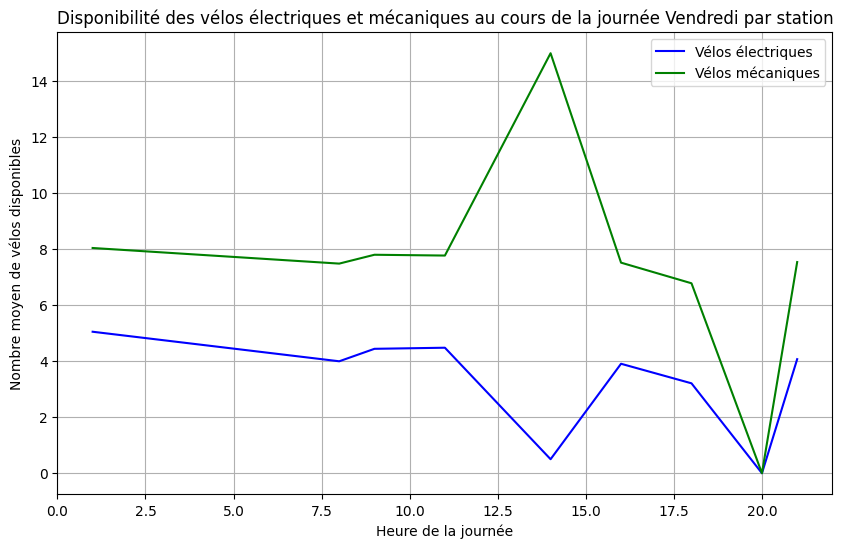

In [414]:
df_friday['hour'] = df_friday['duedate'].dt.hour

availability_per_hour = df_friday.groupby('hour').agg(
    avg_electric_bikes=('ebike', 'mean'),
    avg_mechanical_bikes=('mechanical', 'mean')
).reset_index()

plt.figure(figsize=(10, 6))


plt.plot(availability_per_hour['hour'], availability_per_hour['avg_electric_bikes'], label='Vélos électriques', color='blue')
plt.plot(availability_per_hour['hour'], availability_per_hour['avg_mechanical_bikes'], label='Vélos mécaniques', color='green')

plt.xlabel('Heure de la journée')
plt.ylabel('Nombre moyen de vélos disponibles')
plt.title('Disponibilité des vélos électriques et mécaniques au cours de la journée Vendredi par station')
plt.legend()
plt.grid(True)

plt.show()

In [415]:
import plotly.graph_objects as go

df_friday['hour'] = df_friday['duedate'].dt.hour

availability_per_hour = df_friday.groupby('hour').agg(
    avg_electric_bikes=('ebike', 'mean'),
    avg_mechanical_bikes=('mechanical', 'mean')
).reset_index()

# Création de la figure
fig = go.Figure()

# Ajout des données pour les vélos électriques
fig.add_trace(go.Scatter(
    x=availability_per_hour['hour'],
    y=availability_per_hour['avg_electric_bikes'],
    mode='lines+markers',
    name='Vélos Électriques',
    line=dict(color='blue'),
    marker=dict(size=8)
))

# Ajout des données pour les vélos mécaniques
fig.add_trace(go.Scatter(
    x=availability_per_hour['hour'],
    y=availability_per_hour['avg_mechanical_bikes'],
    mode='lines+markers',
    name='Vélos Mécaniques',
    line=dict(color='green'),
    marker=dict(size=8)
))

# Personnalisation de la mise en page
fig.update_layout(
    title='Disponibilité des vélos électriques et mécaniques au cours de la journée Vendredi par station',
    xaxis_title='Heure de la journée',
    yaxis_title='Nombre moyen de vélos disponibles',
    legend_title='Type de vélo',
    template='plotly_white'
)

# Affichage du graphique
fig.show()
pio.write_html(fig, 'dispo_vendredi.html')


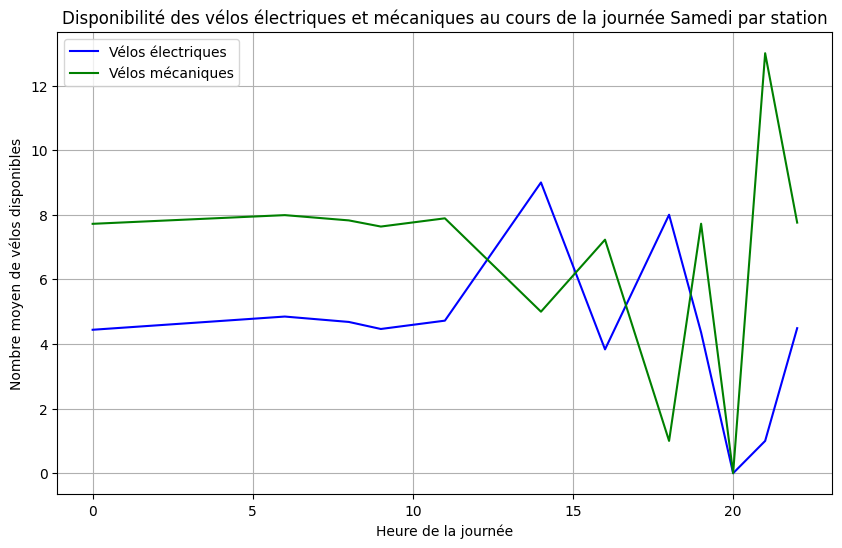

In [416]:
df_saturday['hour'] = df_saturday['duedate'].dt.hour

availability_per_hour = df_saturday.groupby('hour').agg(
    avg_electric_bikes=('ebike', 'mean'),
    avg_mechanical_bikes=('mechanical', 'mean')
).reset_index()

plt.figure(figsize=(10, 6))

plt.plot(availability_per_hour['hour'], availability_per_hour['avg_electric_bikes'], label='Vélos électriques', color='blue')
plt.plot(availability_per_hour['hour'], availability_per_hour['avg_mechanical_bikes'], label='Vélos mécaniques', color='green')

plt.xlabel('Heure de la journée')
plt.ylabel('Nombre moyen de vélos disponibles')
plt.title('Disponibilité des vélos électriques et mécaniques au cours de la journée Samedi par station')
plt.legend()
plt.grid(True)

plt.show()

In [417]:
import plotly.graph_objects as go

df_saturday['hour'] = df_saturday['duedate'].dt.hour

availability_per_hour = df_saturday.groupby('hour').agg(
    avg_electric_bikes=('ebike', 'mean'),
    avg_mechanical_bikes=('mechanical', 'mean')
).reset_index()

# Création de la figure
fig = go.Figure()

# Ajout des données pour les vélos électriques
fig.add_trace(go.Scatter(
    x=availability_per_hour['hour'],
    y=availability_per_hour['avg_electric_bikes'],
    mode='lines+markers',
    name='Vélos Électriques',
    line=dict(color='blue'),
    marker=dict(size=8)
))

# Ajout des données pour les vélos mécaniques
fig.add_trace(go.Scatter(
    x=availability_per_hour['hour'],
    y=availability_per_hour['avg_mechanical_bikes'],
    mode='lines+markers',
    name='Vélos Mécaniques',
    line=dict(color='green'),
    marker=dict(size=8)
))

# Personnalisation de la mise en page
fig.update_layout(
    title='Disponibilité des vélos électriques et mécaniques au cours de la journée Samedi par station',
    xaxis_title='Heure de la journée',
    yaxis_title='Nombre moyen de vélos disponibles',
    legend_title='Type de vélo',
    template='plotly_white'
)

# Affichage du graphique
fig.show()
pio.write_html(fig, 'dispo_samedi.html')


### Jeudi

In [418]:
geojson_file = "communes-france.geojson"  # Remplacez par le chemin du fichier GeoJSON
geo_data = gpd.read_file(geojson_file)

day='thu'

geo_data.columns = geo_data.columns.str.strip()

geo_data = geo_data[geo_data['com_name_lower'].isin(df_thursday['nom_arrondissement_communes'])]

df_thursday['hour'] = df_thursday['duedate'].dt.hour

bins = [8, 12, 16, 20, 24]  
labels = ['8-12h', '12-16h', '16-20h', '20-24h']
df_thursday['time_interval'] = pd.cut(df_thursday['hour'], bins=bins, labels=labels, right=False)

df_mean_capacity = df_thursday.groupby(['nom_arrondissement_communes', 'time_interval'], as_index=False).agg(
    sum_ebike=pd.NamedAgg("ebike", "sum"),
    sum_mechanical=pd.NamedAgg("mechanical", "sum"),
)
df_mean_capacity['total_bike_sum'] = df_mean_capacity['sum_ebike'] + df_mean_capacity['sum_mechanical']

print(df_mean_capacity.describe())

geo_data = geo_data.merge(df_mean_capacity,
                          left_on='com_name_lower',
                          right_on='nom_arrondissement_communes',
                          how='outer')


geo_data['total_bike_sum'] = pd.to_numeric(geo_data['total_bike_sum'], errors='coerce')

min_capacity = geo_data['total_bike_sum'].min()
max_capacity = geo_data['total_bike_sum'].max()
geo_data['normalized_capacity'] = (geo_data['total_bike_sum'] - min_capacity) / (max_capacity - min_capacity)

geo_data['normalized_capacity'].fillna(0, inplace=True)

q25 = geo_data['normalized_capacity'].quantile(0.25)
q50 = geo_data['normalized_capacity'].quantile(0.5)
q75 = geo_data['normalized_capacity'].quantile(0.75)

def get_color_and_opacity(normalized_value):
    if normalized_value < 0:
        return ('white', 0)  
    elif normalized_value <= q25:
        return ('#fc0000', 0.8)  
    elif normalized_value <= q50:
        return ('#fc8700', 0.6)  
    elif normalized_value <= q75:
        return ('#fcdf00', 0.4)  
    else:
        return ('green', 0.2)  

geo_data_og = geo_data.copy()

for i in range (len(labels)):
    geo_data = geo_data_og
    geo_data = geo_data[geo_data['time_interval']== labels[i]]

    m = folium.Map(location=[48.8566, 2.3522], zoom_start=10)
    for _, row in geo_data.iterrows():
        color, opacity = get_color_and_opacity(row['normalized_capacity'])
        folium.GeoJson(
            row['geometry'],
            style_function=lambda feature, fill_color=color, fill_opacity=opacity: {
                'fillColor': fill_color,  
                'color': 'black',
                'weight': 0.7,
                'fillOpacity': fill_opacity,
            },
            tooltip=folium.Tooltip(f"{row['com_name_lower']}: {row['total_bike_sum']} vélos stationnés en moyenne dans la ville")
        ).add_to(m)

    m.save(f"carte_interactive_{day}_{labels[i]}.html")


Skipping field reg_code: unsupported OGR type: 5
Skipping field reg_name: unsupported OGR type: 5
Skipping field dep_code: unsupported OGR type: 5
Skipping field dep_name: unsupported OGR type: 5
Skipping field arrdep_code: unsupported OGR type: 5
Skipping field arrdep_name: unsupported OGR type: 5
Skipping field ze2020_code: unsupported OGR type: 5
Skipping field ze2020_name: unsupported OGR type: 5
Skipping field bv2022_code: unsupported OGR type: 5
Skipping field bv2022_name: unsupported OGR type: 5
Skipping field epci_code: unsupported OGR type: 5
Skipping field epci_name: unsupported OGR type: 5
Skipping field ept_code: unsupported OGR type: 5
Skipping field ept_name: unsupported OGR type: 5
Skipping field com_code: unsupported OGR type: 5
Skipping field com_current_code: unsupported OGR type: 5
Skipping field com_name: unsupported OGR type: 5
/var/folders/jf/fj2024y95fq3vks7z8x5bxnh0000gn/T/ipykernel_7091/2168627793.py:16: FutureWarning:

The default of observed=False is deprecat

         sum_ebike  sum_mechanical  total_bike_sum
count   256.000000      256.000000      256.000000
mean    124.640625      218.132812      342.773438
std     737.006795     1292.742865     2028.707057
min       1.000000        0.000000        1.000000
25%      11.000000       13.000000       24.750000
50%      26.500000       31.000000       57.000000
75%      48.000000       73.250000      117.250000
max    9272.000000    15680.000000    24952.000000


### Vendredi

In [419]:
geojson_file = "communes-france.geojson"  
geo_data = gpd.read_file(geojson_file)

day='fri'


geo_data.columns = geo_data.columns.str.strip()

geo_data = geo_data[geo_data['com_name_lower'].isin(df_friday['nom_arrondissement_communes'])]

df_mean_capacity = df_friday.groupby(['nom_arrondissement_communes','duedate'], as_index=False).agg(
    sum_ebike=pd.NamedAgg("ebike", "sum"),
    sum_mechanical=pd.NamedAgg("mechanical", "sum"),
)

df_mean_capacity['hour'] = df_mean_capacity['duedate'].dt.hour

bins = [1,8,10,12,17,20,24]
labels = ['1-8h','8-10h','10-12h', '12-17h', '17-20h','20-24']
df_mean_capacity['time_interval'] = pd.cut(df_mean_capacity['hour'], bins=bins, labels=labels, right=False)

df_mean_capacity['total_bike_sum'] = (df_mean_capacity['sum_ebike'] + df_mean_capacity['sum_mechanical'])

print(df_mean_capacity.describe())


geo_data = geo_data.merge(df_mean_capacity,
                          left_on='com_name_lower',
                          right_on='nom_arrondissement_communes',
                          how='outer')

geo_data['total_bike_sum'] = pd.to_numeric(geo_data['total_bike_sum'], errors='coerce')


min_capacity = geo_data['total_bike_sum'].min()
max_capacity = geo_data['total_bike_sum'].max()
geo_data['normalized_capacity'] = (geo_data['total_bike_sum'] - min_capacity) / (max_capacity - min_capacity)

geo_data['normalized_capacity'].fillna(0, inplace=True)

q25 = geo_data['normalized_capacity'].quantile(0.25)
q50 = geo_data['normalized_capacity'].quantile(0.5)
q75 = geo_data['normalized_capacity'].quantile(0.75)

def get_color_and_opacity(normalized_value):
    if normalized_value < 0:
        return ('white', 0)  
    elif normalized_value <= q25:
        return ('#fc0000', 0.8)  
    elif normalized_value <= q50:
        return ('#fc8700', 0.6)  
    elif normalized_value <= q75:
        return ('#fcdf00', 0.4)  
    else:
        return ('green', 0.2)  

geo_data_og = geo_data.copy()

for i in range (len(labels)):
    geo_data = geo_data_og
    geo_data = geo_data[geo_data['time_interval']== labels[i]]

    m = folium.Map(location=[48.8566, 2.3522], zoom_start=10)
    for _, row in geo_data.iterrows():
        color, opacity = get_color_and_opacity(row['normalized_capacity'])
        folium.GeoJson(
            row['geometry'],
            style_function=lambda feature, fill_color=color, fill_opacity=opacity: {
                'fillColor': fill_color,  
                'color': 'black',
                'weight': 0.7,
                'fillOpacity': fill_opacity,
            },
            tooltip=folium.Tooltip(f"{row['com_name_lower']}: {row['total_bike_sum']} vélos stationnés en moyenne dans la ville")
        ).add_to(m)

    m.save(f"carte_interactive_{day}_{labels[i]}.html")


Skipping field reg_code: unsupported OGR type: 5
Skipping field reg_name: unsupported OGR type: 5
Skipping field dep_code: unsupported OGR type: 5
Skipping field dep_name: unsupported OGR type: 5
Skipping field arrdep_code: unsupported OGR type: 5
Skipping field arrdep_name: unsupported OGR type: 5
Skipping field ze2020_code: unsupported OGR type: 5
Skipping field ze2020_name: unsupported OGR type: 5
Skipping field bv2022_code: unsupported OGR type: 5
Skipping field bv2022_name: unsupported OGR type: 5
Skipping field epci_code: unsupported OGR type: 5
Skipping field epci_name: unsupported OGR type: 5
Skipping field ept_code: unsupported OGR type: 5
Skipping field ept_name: unsupported OGR type: 5
Skipping field com_code: unsupported OGR type: 5
Skipping field com_current_code: unsupported OGR type: 5
Skipping field com_name: unsupported OGR type: 5
/var/folders/jf/fj2024y95fq3vks7z8x5bxnh0000gn/T/ipykernel_7091/2349548476.py:39: FutureWarning:

A value is trying to be set on a copy of 

         sum_ebike  sum_mechanical         hour  total_bike_sum
count  5530.000000     5530.000000  5530.000000     5530.000000
mean      7.557505       13.724412    11.850814       21.281917
std      10.690623       23.892257     6.385771       32.998944
min       0.000000        0.000000     1.000000        0.000000
25%       2.000000        1.000000     8.000000        4.000000
50%       4.000000        5.000000    11.000000       11.000000
75%       9.000000       16.000000    18.000000       23.000000
max     103.000000      264.000000    21.000000      367.000000


### Samedi

In [420]:
geojson_file = "communes-france.geojson"  
geo_data = gpd.read_file(geojson_file)

day='sat'


geo_data.columns = geo_data.columns.str.strip()

geo_data = geo_data[geo_data['com_name_lower'].isin(df_saturday['nom_arrondissement_communes'])]

df_mean_capacity = df_saturday.groupby(['nom_arrondissement_communes', 'duedate'], as_index=False).agg(
    sum_ebike=pd.NamedAgg("ebike", "sum"),
    sum_mechanical=pd.NamedAgg("mechanical", "sum"),
)

df_mean_capacity['hour'] = df_mean_capacity['duedate'].dt.hour

bins = [1,8,10,12,17,20,24] 
labels = ['1-8h','8-10h','10h-12h', '12-17h', '17-20h','20-24']
df_mean_capacity['time_interval'] = pd.cut(df_mean_capacity['hour'], bins=bins, labels=labels, right=False)


df_mean_capacity['total_bike_sum'] = df_mean_capacity['sum_ebike'] + df_mean_capacity['sum_mechanical']

# Fusion des données
geo_data = geo_data.merge(df_mean_capacity,
                          left_on='com_name_lower',
                          right_on='nom_arrondissement_communes',
                          how='outer')

# Convertir total_bike_sum en numérique
geo_data['total_bike_sum'] = pd.to_numeric(geo_data['total_bike_sum'], errors='coerce')

# Normalisation des capacités
min_capacity = geo_data['total_bike_sum'].min()
max_capacity = geo_data['total_bike_sum'].max()
geo_data['normalized_capacity'] = (geo_data['total_bike_sum'] - min_capacity) / (max_capacity - min_capacity)

# Vérifier les valeurs NaN
geo_data['normalized_capacity'].fillna(0, inplace=True)

# Calcul des quartiles
q25 = geo_data['normalized_capacity'].quantile(0.25)
q50 = geo_data['normalized_capacity'].quantile(0.5)
q75 = geo_data['normalized_capacity'].quantile(0.75)

# Fonction de couleur et opacité
def get_color_and_opacity(normalized_value):
    if normalized_value < 0:
        return ('white', 0)  # Aucune station
    elif normalized_value <= q25:
        return ('#fc0000', 0.8)  # Rouge
    elif normalized_value <= q50:
        return ('#fc8700', 0.6)  # Orange
    elif normalized_value <= q75:
        return ('#fcdf00', 0.4)  # Jaune
    else:
        return ('green', 0.2)  # Vert

geo_data_og = geo_data.copy()

for i in range (len(labels)):
    geo_data = geo_data_og
    geo_data = geo_data[geo_data['time_interval']== labels[i]]

    m = folium.Map(location=[48.8566, 2.3522], zoom_start=10)
    for _, row in geo_data.iterrows():
        color, opacity = get_color_and_opacity(row['normalized_capacity'])
        folium.GeoJson(
            row['geometry'],
            style_function=lambda feature, fill_color=color, fill_opacity=opacity: {
                'fillColor': fill_color,  
                'color': 'black',
                'weight': 0.7,
                'fillOpacity': fill_opacity,
            },
            tooltip=folium.Tooltip(f"{row['com_name_lower']}: {row['total_bike_sum']} vélos stationnés en moyenne dans la ville")
        ).add_to(m)

    m.save(f"carte_interactive_{day}_{labels[i]}.html")


Skipping field reg_code: unsupported OGR type: 5
Skipping field reg_name: unsupported OGR type: 5
Skipping field dep_code: unsupported OGR type: 5
Skipping field dep_name: unsupported OGR type: 5
Skipping field arrdep_code: unsupported OGR type: 5
Skipping field arrdep_name: unsupported OGR type: 5
Skipping field ze2020_code: unsupported OGR type: 5
Skipping field ze2020_name: unsupported OGR type: 5
Skipping field bv2022_code: unsupported OGR type: 5
Skipping field bv2022_name: unsupported OGR type: 5
Skipping field epci_code: unsupported OGR type: 5
Skipping field epci_name: unsupported OGR type: 5
Skipping field ept_code: unsupported OGR type: 5
Skipping field ept_name: unsupported OGR type: 5
Skipping field com_code: unsupported OGR type: 5
Skipping field com_current_code: unsupported OGR type: 5
Skipping field com_name: unsupported OGR type: 5
/var/folders/jf/fj2024y95fq3vks7z8x5bxnh0000gn/T/ipykernel_7091/20484327.py:40: FutureWarning:

A value is trying to be set on a copy of a 